In [7]:
ae_path = '/scratch/sagar/Projects/matlab/deep-spectrum-cartography/deep_prior/trained_models/slf_network.model'
ae_network = torch.load(ae_path)

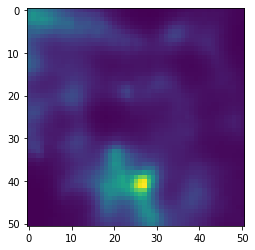

In [13]:
import matplotlib.pyplot as plt

plt.imshow(network.decoder(torch.randn(1,256)).squeeze().detach().numpy())

[tensor(nan, grad_fn=<DivBackward0>)]

0


Text(0.5, 1.0, 'Objective Value')

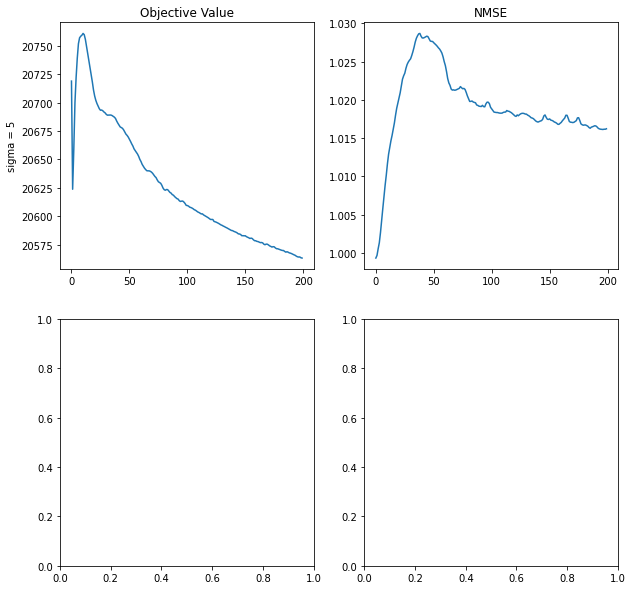

In [8]:
fig, ax = plt.subplots(len(var_list)+1, 2, figsize=(10,10))
for i in range(len(var_list)):
    print(i)
    ax[i, 0].plot(costs[i])
    ax[i, 0].set_ylabel('sigma = '+str(var_list[i]))
    ax[i, 1].plot(nmses[i])
ax[0,1].set_title('NMSE')
ax[0,0].set_title('Objective Value')


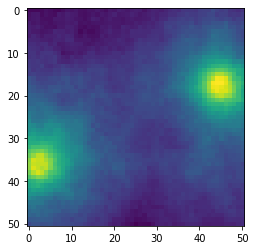

In [9]:
import matplotlib.pyplot as plt
import torch
import numpy as np
import scipy.io as sio
from qmc_utils import init_z, load_generator, load_data

S, C, T, S_true, C_true, T_true = load_data()

plt.imshow(torch.log(T_true[:,:,5]))

Text(0.5, 0.98, 'Reconstruction using ML criterion, shadow variance = 3, decorrelation distance = 90, 2 bits per scalar, 10% sampling')

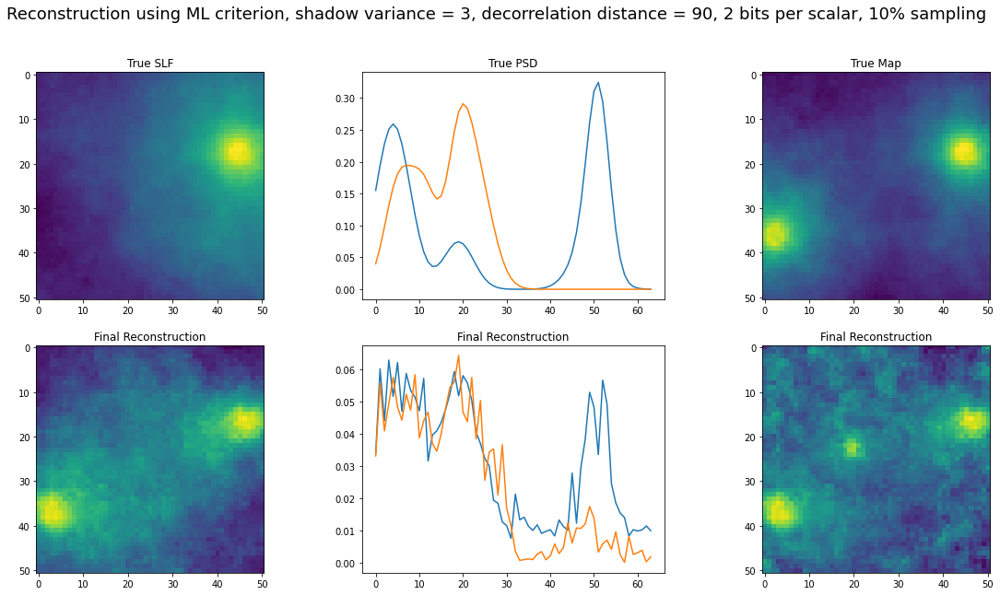

In [14]:
fig, ax = plt.subplots(2,3, figsize=(20,10))

ax[0,0].imshow(torch.log(S_true[0,...]).squeeze().detach().numpy())
ax[0,0].set_title('True SLF')
ax[1,0].imshow(torch.log(S[1,...]).squeeze().detach().numpy())
ax[1,0].set_title('Final Reconstruction')

ax[0,1].plot(C_true[0,:].detach().numpy())
ax[0,1].set_title('True PSD')
ax[1,1].plot(C[0,:].detach().numpy())
ax[1,1].set_title('Final Reconstruction')


ax[0,1].plot(C_true[1,:].detach().numpy())
ax[0,1].set_title('True PSD')
ax[1,1].plot(C[1,:].detach().numpy())
ax[1,1].set_title('Final Reconstruction')

k = 5
T_hat = get_tensor(S, C)

ax[0,2].imshow(torch.log(T_true[k,...]).squeeze().detach().numpy())
ax[0,2].set_title('True Map')
ax[1,2].imshow(torch.log(T_hat[k,...]).squeeze().detach().numpy())
ax[1,2].set_title('Final Reconstruction')

fig.suptitle('Reconstruction using ML criterion, shadow variance = 3, decorrelation distance = 90, 2 bits per scalar, 10% sampling', fontsize=18)


In [24]:
fig.savefig('data/ml_small_shadowing_image.pdf')

Text(0.5, 0.98, 'Reconstruction using ML criterion, shadow variance = 3, decorrelation distance = 90, 2 bits per scalar, 10% sampling')

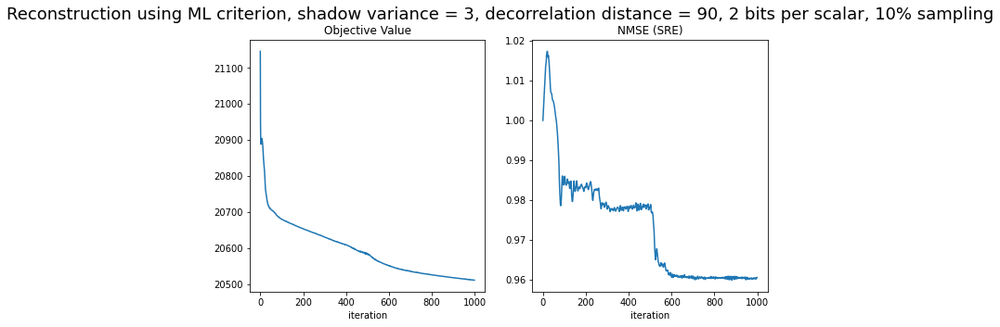

In [25]:
fig, ax = plt.subplots(len(var_list), 2, figsize=(10,5))
ax[0].plot(costs[0])
# ax[0].set_ylabel('sigma = '+str(var_list[i]))
ax[1].plot(nmses[0])
ax[1].set_title('NMSE (SRE)')
ax[0].set_title('Objective Value')
ax[0].set_xlabel('iteration')
ax[1].set_xlabel('iteration')

fig.suptitle('Reconstruction using ML criterion, shadow variance = 3, decorrelation distance = 90, 2 bits per scalar, 10% sampling', fontsize=18)


In [26]:
fig.savefig('data/ml_small_shadowing_plot.pdf')

In [17]:
folder_name = '5_percent_backup_compare'

In [18]:

torch.save(T_true, 'data/' + folder_name + '/T_true.pt')
torch.save(C_true, 'data/' + folder_name + '/C_true.pt')
torch.save(S_true, 'data/' + folder_name + '/S_true.pt')
torch.save(T_hat, 'data/' + folder_name + '/T_hat.pt')
torch.save(C, 'data/' + folder_name + '/C.pt')
torch.save(S, 'data/' + folder_name + '/S.pt')

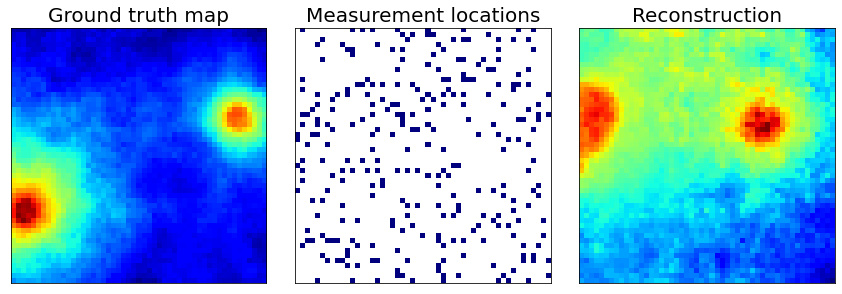

In [13]:
fig, ax = plt.subplots(1,3, figsize=(12, 4))
cmap = plt.cm.get_cmap("jet")
k = 17
fontsize = 20

folder_name = '5_percent_backup'
T_qmc = torch.load('data/' + folder_name + '/T_hat.pt')
S_qmc = torch.load('data/' + folder_name + '/S.pt')

ax[0].imshow(torch.log(T_true[k,...]).squeeze().detach().numpy(), cmap=cmap)
ax[0].set_xticks([])
ax[0].set_yticks([])
ax[0].set_title('Ground truth map', fontsize=fontsize)
# ax[0].set_xlabel('(a)', fontsize=fontsize)

Om = Wx[k,...]
Om[Om==0] = np.nan
ax[1].imshow((Wx[k,...]).squeeze().detach().numpy(), cmap=cmap)
ax[1].set_xticks([])
ax[1].set_yticks([])
ax[1].set_title('Measurement locations', fontsize=fontsize)
# ax[0,2].set_xlabel('(b)', fontsize=fontsize)


ax[2].imshow((torch.log(T_qmc[k,...])).squeeze().detach().numpy(), cmap=cmap)
ax[2].set_xticks([])
ax[2].set_yticks([])
ax[2].set_title('Reconstruction', fontsize=fontsize)
# ax[0,2].set_xlabel('(b)', fontsize=fontsize)
plt.tight_layout()

In [38]:
fig.savefig('qmc_mle.pdf')

In [11]:
-(Wx[k,...]*torch.log(T_true[k

tensor(1725.6879)

In [5]:
Wx[k,...].sum()

tensor(248.)

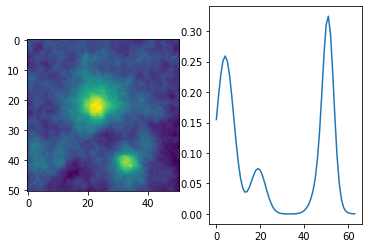

iter 499, cost: 20497.208984375, nmse: 1.3556288480758667
ended 5


<Figure size 432x288 with 0 Axes>

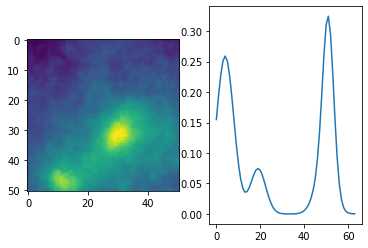

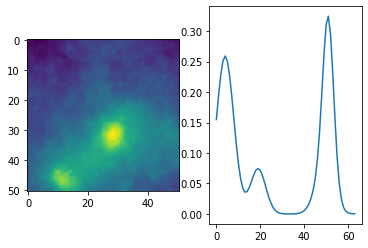

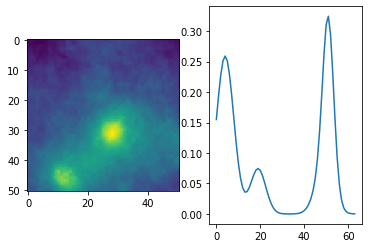

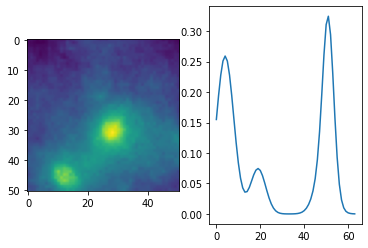

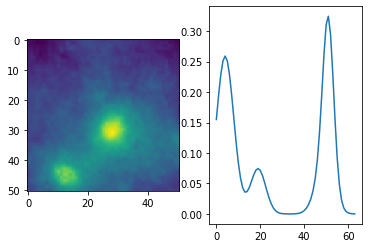

...

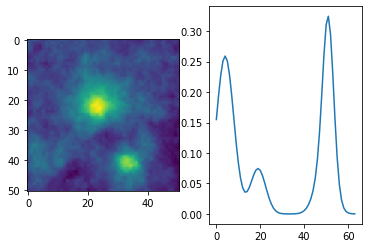

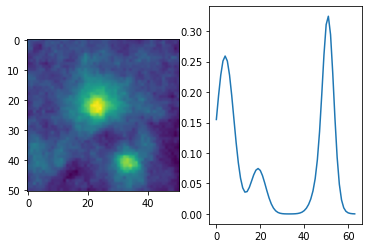

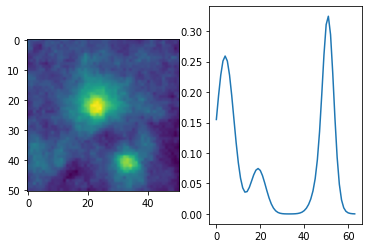

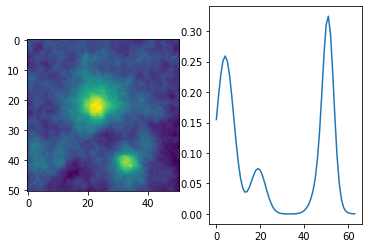

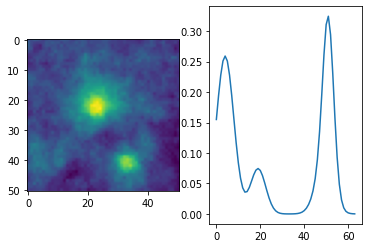

In [3]:
import matplotlib.pyplot as plt
import torch
import numpy as np
import os
import sys
from networks.gan import Generator, Generator256, Generator512
import scipy.io as sio
import torch
from utils import *
from quantization_model_log import *
from tqdm import trange
from qmc_utils import init_z, load_generator, load_data
from IPython.display import clear_output, display

S, C, T, S_true, C_true, T_true = load_data()
generator = load_generator()
generator = Generator256()
GAN_PATH = '/home/sagar/Projects/matlab/quantized_spectrum_cartography/deep_prior/trained_models/gan/sngan11_256_unnorm'
GAN_PATH_SERVER = '/scratch/sagar/Projects/matlab/quantized_spectrum_cartography/deep_prior/trained_models/gan/sngan11_256_unnorm'
try:
    checkpoint = torch.load(GAN_PATH, map_location=torch.device('cpu'))
except:
    checkpoint = torch.load(GAN_PATH_SERVER, map_location=torch.device('cpu'))

generator.load_state_dict(checkpoint['g_model_state_dict'])
generator.eval()

# ae_path = '/scratch/sagar/Projects/matlab/deep-spectrum-cartography/deep_prior/trained_models/slf_network.model'
# ae_network = torch.load(ae_path)
# ae_network.eval()
# generator = ae_network.decoder


# parameters
z_dimension = 256
maxIter = 500
R,I,J = S.shape
K = 64
Z_init = torch.zeros((R, z_dimension), dtype=torch.float32)
Z = torch.zeros((R, z_dimension), dtype=torch.float32)
lambda_c =  100
lambda_s =  100
f = 0.1
std_probit = 0.008
loss_model = 'probit'  # one of 'sigmoid', 'probit', and 'determ'
cinnerIter = 1
sinnerIter = 1

nmse_list = []

# Mask
Om = torch.ones((64,1,51,51))*f
Om = torch.bernoulli(Om)
Wx = Om

T = T.permute(2,0,1)
T_true = T_true.permute(2,0,1)
S = S.permute(2,0,1)
S_true = S_true.permute(2,0,1)
C = C.permute(1,0)
C_true = C_true.permute(1,0)

T_old = T.clone()
S_old = S.clone()

# bin_boundaries = torch.tensor(QUANTIZATION_BOUNDARIES_7_ADJUSTED)
# offset = LOG_OFFSET_7_ADJUSTED

bin_boundaries = torch.tensor(QUANTIZATION_BOUNDARIES_4_BINS)
offset = LOG_OFFSET_4

# warm start
C_init = C.clone()
S_init = S.clone()
S_init = S_init.unsqueeze(dim=1)

# zero start
S_init = torch.zeros(S_init.shape)
C_init = torch.zeros(C_init.shape)

T = T.unsqueeze(dim=1)
T_init = get_tensor(S_init, C_init)
var_list = [SD_4_BINS*2]
# var_list = [5]
var_list = [5]

Z_init = torch.randn((R, 256))

nmses = np.zeros((len(var_list), maxIter))
costs = np.zeros((len(var_list), maxIter))

for var_id in range(len(var_list)):
    var = var_list[var_id]
    std_probit = var
#     T_true = torch.log(T_true)
    Y = quantize(T_true, std_probit, bin_boundaries, offset=offset)
    Y = Y.unsqueeze(dim=1)
    
    S = S_init.clone()
    C = C_init.clone()
    Z = Z_init.clone()

    Z = Z.detach().clone()
    C.requires_grad = True
    Z.requires_grad = True

    optimizerC = torch.optim.Adam([C], lr=0.005)
    optimizerZ = torch.optim.Adam([Z], lr=0.01)

    with torch.no_grad():
        S = generator(Z)

    print("Initial nmse: {}".format(NMSE(get_tensor(generator(Z), C), T_true)))
    import time
    for i in range(maxIter):
        
#         C optimization
#         for c_inner in range(cinnerIter):
#             Sc = S.detach().clone()
#             optimizerC.zero_grad()

#             T_hat = get_tensor(Sc, C)
#             T_hat = T_hat.unsqueeze(dim=1)
#             T_hat = torch.log(T_hat+offset)

#             neg_log_likelihood = -torch.sum(Wx*torch.log(prob_probit(Y, T_hat, bin_boundaries, std_probit)))
#             cost = neg_log_likelihood + lambda_c*torch.norm(C, 'fro') + lambda_s*torch.norm(Z, 'fro')

#             cost.backward()
#             optimizerC.step()
#         with torch.no_grad():
#             C[C<0] = 0
            
#         true_loss = NMSE(get_tensor(S,C), T_true)
#         nmses[var_id][i] = true_loss
#         costs[var_id][i] = cost

        
        # S optimization
#         if i==1:
#             # First select a good random vector
#             min_criterion = 9999999
#             for i in range(200):
#                 temp = torch.randn((R,z_dimension), dtype=torch.float32)
#                 temp_out = generator(temp)
                
#                 T_hat = get_tensor(temp_out, C)
#                 T_hat = T_hat.unsqueeze(dim=1)
#                 T_hat = torch.log(T_hat+offset)
#                 neg_log_likelihood = -torch.sum(Wx*torch.log(prob_probit(Y, T_hat, bin_boundaries, std_probit)))
#                 temp_criterion = neg_log_likelihood + lambda_c*torch.norm(C, 'fro') + lambda_s*torch.norm(S, 'fro')
                
#                 if  temp_criterion < min_criterion:
#                     Z.data = temp.clone()
#                     min_criterion = temp_criterion
#                     print('min_first', min_criterion)

#             for i in range(200):
#                 temp = 0.2*torch.randn((R,z_dimension), dtype=torch.float32) + Z
#                 T_hat = get_tensor(temp_out, C)
#                 T_hat = T_hat.unsqueeze(dim=1)
#                 T_hat = torch.log(T_hat+offset)
#                 neg_log_likelihood = -torch.sum(Wx*torch.log(prob_probit(Y, T_hat, bin_boundaries, std_probit)))
#                 temp_criterion = neg_log_likelihood + lambda_c*torch.norm(C, 'fro') + lambda_s*torch.norm(S, 'fro')
#                 if  temp_criterion < min_criterion:
#                     Z.data = temp.clone()
#                     min_criterion = temp_criterion
#                     print('min_second', min_criterion)
        
        C = C_true.clone()
        for inner_s in range(sinnerIter):
            optimizerZ.zero_grad()
            S = generator(Z)

            T_hat = get_tensor(S, C)
            T_hat = T_hat.unsqueeze(dim=1)
            T_hat = torch.log(T_hat+offset)
            neg_log_likelihood = -torch.sum(Wx*torch.log(prob_probit(Y, T_hat, bin_boundaries, std_probit)))
            cost = neg_log_likelihood + lambda_c*torch.norm(C, 'fro') + lambda_s*torch.norm(Z, 'fro')

            cost.backward()
            optimizerZ.step()

        true_loss = NMSE(get_tensor(S,C), T_true)
        nmses[var_id][i] = true_loss
        costs[var_id][i] = cost

        clear_output(wait=True)    
        display(plt.gcf())
        fig, ax = plt.subplots(1,2)
        print('iter {}, cost: {}, nmse: {}'.format(i, cost, true_loss))
        ax[0].imshow(T_hat[17,...].squeeze().detach().numpy())
        ax[1].plot(C[0,:].detach().numpy())

    print('ended {}'.format(std_probit))
    nmse_list.append(true_loss)

In [24]:
neg_log_likelihood

tensor(33607.9023, grad_fn=<NegBackward>)

In [22]:
lambda_c*torch.norm(C, 'fro')

tensor(48.8152, grad_fn=<MulBackward0>)

In [23]:
lambda_s*torch.norm(Z, 'fro')

tensor(6536.6899, grad_fn=<MulBackward0>)

In [32]:
C[0]

tensor([0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300,
        0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300,
        0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300,
        0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300,
        0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300,
        0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300,
        0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300, 0.0300,
        0.0300], grad_fn=<SelectBackward>)

In [29]:
C.shape

torch.Size([2, 64])